#Video Search Engine
In this notebook, I'll show an experiment that uses [OpenAI's CLIP](https://openai.com/blog/clip/) model to build and demonstrate a tiny video search engine and indexer.

Please [read the associated blog article for this notebook](https://www.storminthecastle.com) for more details on the implemementation.

##**You'll definitely want to enable the GPU runtime for this notebook or indexing will take a very long time.**

For updates and more content follow me on twitter [@johnrobinsn](https://www.twitter.com/johnrobinsn) or on my blog [storminthecastle.com](https://www.storminthecastle.com).

## Install Some Dependencies

In [5]:
!pip install --upgrade git+https://github.com/openai/CLIP.git
!pip install patchify
!pip install gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-xs69djfc
  Running command git clone -q https://github.com/openai/CLIP.git /tmp/pip-req-build-xs69djfc
     |████████████████████████████████| 53 kB 1.8 MB/s 
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369387 sha256=1a419bc270917c2756dc57adc7af8cfcd93f76ebf973f101d7f6cdc0bd9c15ad
  Stored in directory: /tmp/pip-ephem-wheel-cache-59o5ytbx/wheels/fd/b9/c3/5b4470e35ed76e174bff77c92f91da82098d5e35fd5bc8cdac
Successfully built clip
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [8]:
url = 'https://youtu.be/ozdy8b4y1zQ'
from IPython.display import HTML
HTML(f"""<video src={url} mimeType="video/mp4" autoplay loop width=600 controls"/>""")

## Preview Sample Video
Here is a 720p sample video (3:06 in length) that is used in this notebook for demonstration purposes. This is a
[Video by Kelly L from Pexels](https://www.pexels.com/video/a-residential-and-commercial-neighborhood-4615493/?utm_content=attributionCopyText&utm_medium=referral&utm_source=pexels).  If you appreciated this notebook or associated blog article, please consider making a donation to the videographer Kelly L given the provided link.

## Download Sample Video
Download the video file to this notebook's VM so that we can use it for this experiment.

In [13]:
!gdown -O kitchen.mp4 https://drive.google.com/uc?id=1Jw9OuYjp0gorp-JA06Dbtt7K8hWg4yPv
 

Downloading...
From: https://drive.google.com/uc?id=1Jw9OuYjp0gorp-JA06Dbtt7K8hWg4yPv
To: /content/kitchen.mp4
100% 6.08M/6.08M [00:00<00:00, 14.1MB/s]


## Import Some Python Modules

In [14]:
import math
import logging
import numpy as np
from matplotlib import pyplot as plt
import cv2
from PIL import Image
from patchify import patchify
import torch
import clip
from tqdm.notebook import tqdm as tqdm

logging.basicConfig(format='%(message)s',level=logging.INFO)

##Define Some Utility Functions for Video Handling

In [15]:
# generator yielding a video frame and a frame timestamp (seconds) each time
def video_frames(path):
  video = cv2.VideoCapture(path)
  fps = video.get(cv2.CAP_PROP_FPS)
  ret, frame = video.read()
  count = 0
  while ret:
    count = count + 1
    frame = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
    yield frame,count/fps
    ret, frame = video.read()

# returns a single video frame at the specified timestamp (seconds)
def video_frame(path,timestamp=0):
  video = cv2.VideoCapture(path)
  fps = video.get(cv2.CAP_PROP_FPS)
  video.set(cv2.CAP_PROP_POS_MSEC, timestamp * 1000)
  ret,frame = video.read()
  frame = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
  return frame if ret else None

# returns duration of the specified video
def video_duration(path):
  video = cv2.VideoCapture(path)
  fps = video.get(cv2.CAP_PROP_FPS)
  frame_count = video.get(cv2.CAP_PROP_FRAME_COUNT)
  return frame_count/fps

## Show a Frame from the Sample Video

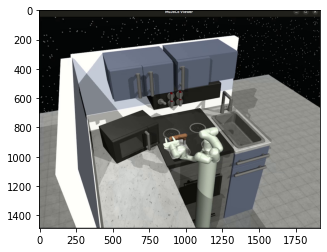

In [16]:
f = video_frame('kitchen.mp4')
plt.imshow(f)
plt.show()

## Indexer and Search Engine
This cell contains the entire CLIP-based video indexer and search engine.

In [17]:
class ClipIndex:
  def __init__(self,patch_size=720//2):
    self.patch_size = patch_size
    self.patch_shape = (self.patch_size,self.patch_size,3)
    self.patch_step = self.patch_size//2
    self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
    logging.info("Loading CLIP Model")
    self.clip_model,self.clip_prep = clip.load('RN50x4',self.device,jit=False)
    # This will be our video
    # index_feature will be a tensor that contains all of the CLIP features encoded for our video
    self.index_features = None
    # contains the metadata for every image feature held in index_features
    self.index_metadata = []

  def indexVideo(self,path,freq=1.0):
    last_index = 0
    duration = video_duration(path)
    logging.info('Indexing: {}'.format(path))
    with tqdm(total=math.ceil(duration)) as progress_bar:
      for frame,timestamp in video_frames(path):
        if timestamp - last_index > freq:
          progress_bar.update(math.floor(timestamp)-progress_bar.n)
          last_index = timestamp
          frame_features = []
          frame_metadata = []
          # chop frame up into patches
          patches = patchify(frame,self.patch_shape,self.patch_step).squeeze()
          # patches is a 2d array of images patches lets unravel into a 1d array of patches
          shape = patches.shape
          patches = patches.reshape(shape[0]*shape[1],*self.patch_shape)
          # clip wants PIL image objects
          pils = []
          for p in patches:
            frame_metadata.append({'path':path,'t':timestamp})
            pils.append(self.clip_prep(Image.fromarray(p)))
          # put all of the images patches into a single tensor
          tensor = torch.stack(pils,dim=0)
          uploaded = tensor.to(self.device)
          # ask CLIP to encode the image features for our patches into a feature vector
          with torch.no_grad():
            frame_features = self.clip_model.encode_image(uploaded)
          assert(frame_features.shape[0] == len(frame_metadata))
          # normalize the image feature vectors so that they all have a length of 1
          frame_features /= frame_features.norm(dim=-1,keepdim=True)
          if self.index_features is not None:
            self.index_features = torch.cat((self.index_features,frame_features),dim=0)
          else:
            self.index_features = frame_features
          self.index_metadata.extend(frame_metadata)
      progress_bar.update(progress_bar.total-progress_bar.n)

  def search(self,query,n=6,threshold=35):
    # ask CLIP to encode our query into a feature vector
    query_tensor = torch.cat([clip.tokenize(query)]).to(self.device)
    with torch.no_grad():
      query_features = self.clip_model.encode_text(query_tensor)
    # normalize the query feature vector so that it has a length of 1
    query_features /= query_features.norm(dim=-1,keepdim=True)
    # do the actual search here by calculating the distances between the query vector
    # and all of the image features from our video with a single dot product
    similarity = (100.0 * query_features @ self.index_features.T)
    # lets pull out the best matches
    values,indices = similarity[0].topk(min(n*10,len(self.index_metadata)))
    # build and return the result set
    result = []
    time=0
    for i,d in enumerate(zip(values,indices)):
      # i: count; d[0]: score; d[1]: index
      meta = self.index_metadata[d[1]]
      if len(result) < n and d[0] > threshold and abs(meta['t']-time) > 0.1:
        time = meta['t']
        result.append({'score':float(d[0]),'path':meta['path'],'t':meta['t']})
    return result

## Index the Sample Video

In [18]:
index = ClipIndex()
index.indexVideo('kitchen.mp4')

Loading CLIP Model
100%|███████████████████████████████████████| 402M/402M [00:08<00:00, 47.6MiB/s]
Indexing: kitchen.mp4


  0%|          | 0/23 [00:00<?, ?it/s]

## Search
Here we try out a quick search for the query, "a red car".  The return result consists of an array of JSON objects that each contain the path to the indexed video, the score of the result and timestamp of the match.

In [19]:
index.search('opening microwave')

[{'path': 'kitchen.mp4', 'score': 35.84375, 't': 1.0666666666666667},
 {'path': 'kitchen.mp4', 'score': 35.84375, 't': 3.1333333333333333},
 {'path': 'kitchen.mp4', 'score': 35.84375, 't': 12.6},
 {'path': 'kitchen.mp4', 'score': 35.8125, 't': 1.0666666666666667},
 {'path': 'kitchen.mp4', 'score': 35.625, 't': 2.066666666666667},
 {'path': 'kitchen.mp4', 'score': 35.59375, 't': 11.533333333333333}]

In [20]:
# A utility function that given results from a video search renders the matching
# frames in a notebook cell.
def show_results(matches):
  if len(matches) > 0:
    rows = int(math.ceil(len(matches)/2))
    fig,ax = plt.subplots(rows,2,figsize=(20,rows*6))
    a = ax.ravel()
    for i,m in enumerate(matches):
      frame = video_frame(m['path'],timestamp=m['t'])
      a[i].imshow(frame)
      a[i].set_title('time:{} score:{}'.format(round(m['t'],1),round(m['score'],2)))
    for ax in fig.axes:
        ax.axis("off")
    plt.tight_layout()
    plt.show()
  else:
    print('No matches found')

# More Searches
Let's try some more searches and show the matching video frames.  Note that CLIP is not perfect (as you might expect), but can give some surprisingly great results.  Give these a try and then try a few of your own queries.  You can even try loading your own video and running your own experiments.

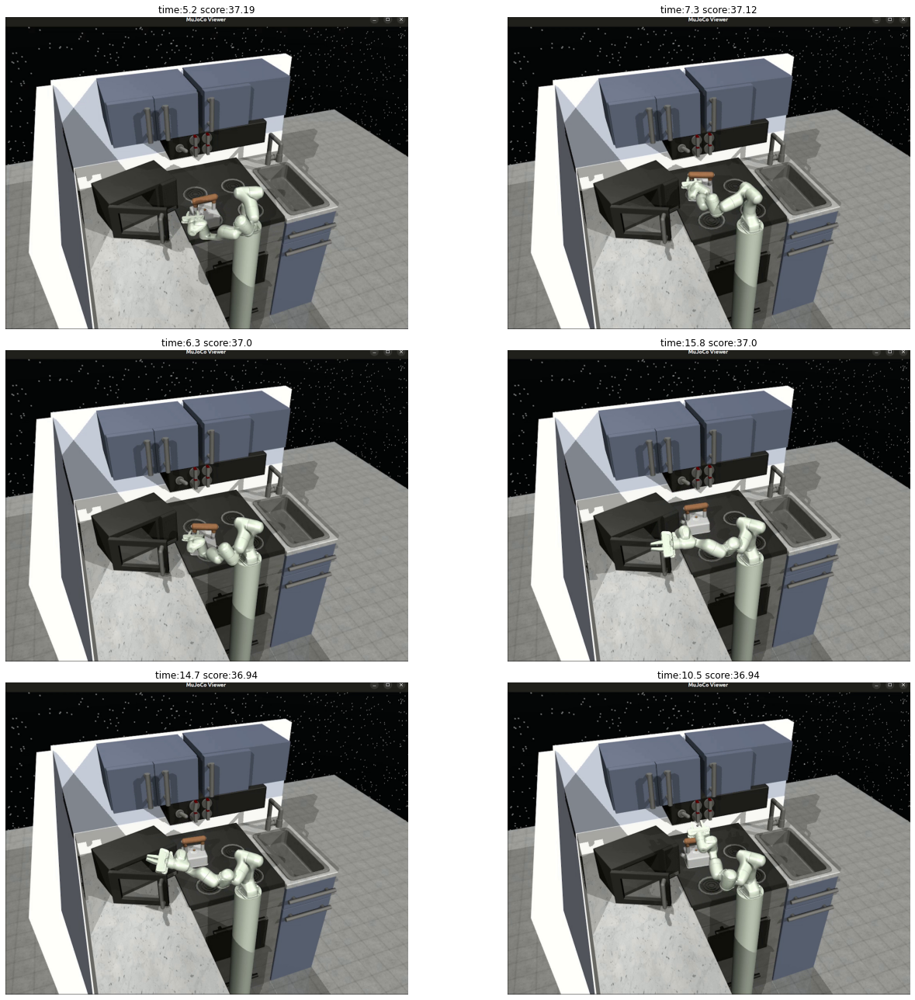

In [25]:
show_results(index.search('touching microwave door handle'))

### CLIP is even able to match text within the video frames!  In this case the word "chicken".

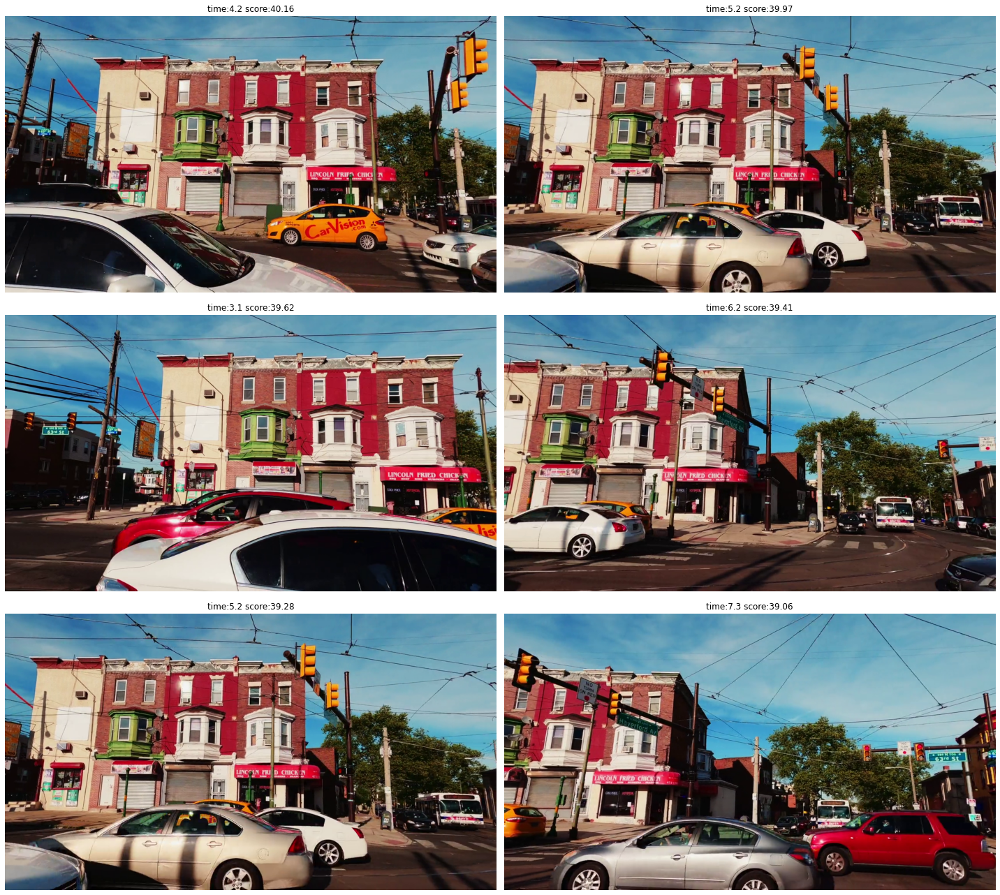

In [ ]:
show_results(index.search('a sign with the text "chicken"'))

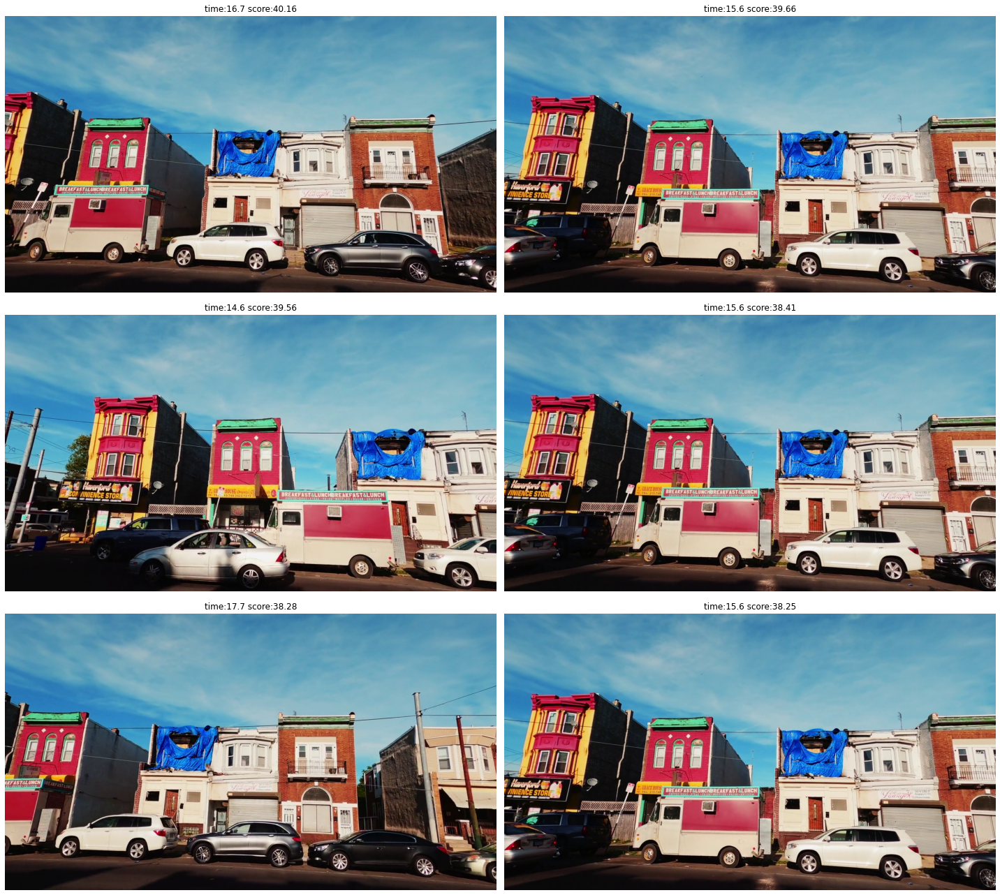

In [ ]:
show_results(index.search('a food truck'))

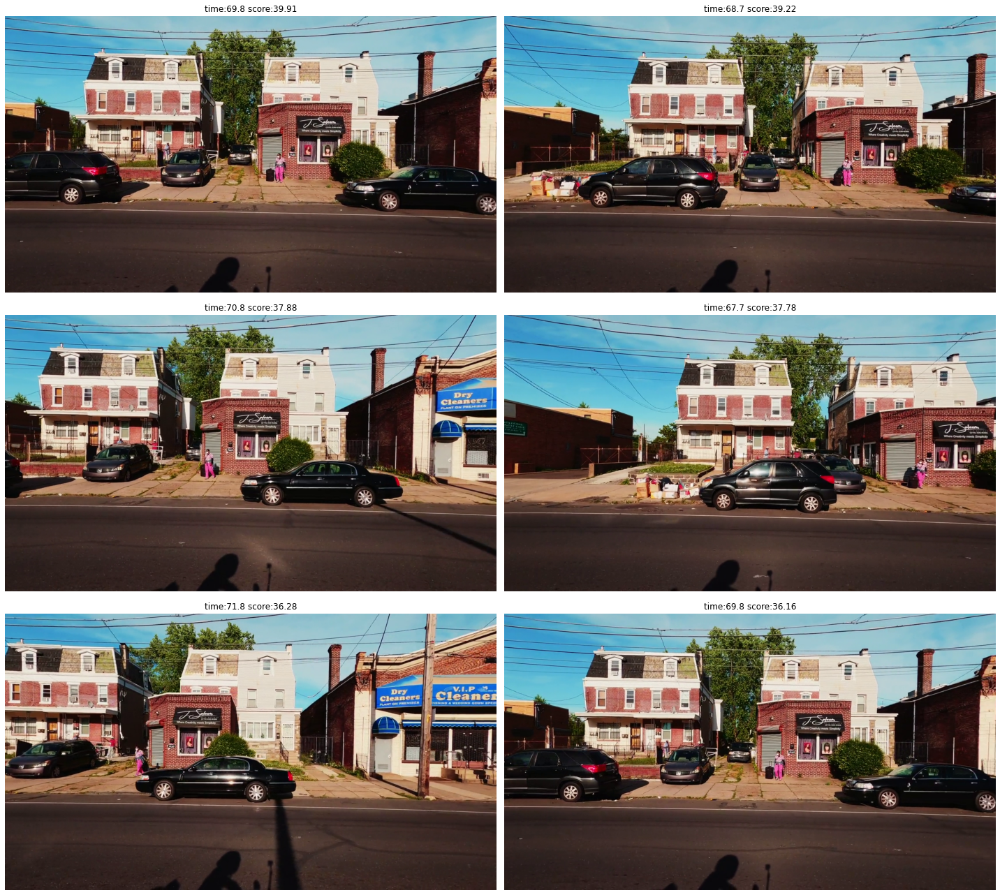

In [ ]:
show_results(index.search('a woman in pink pants'))

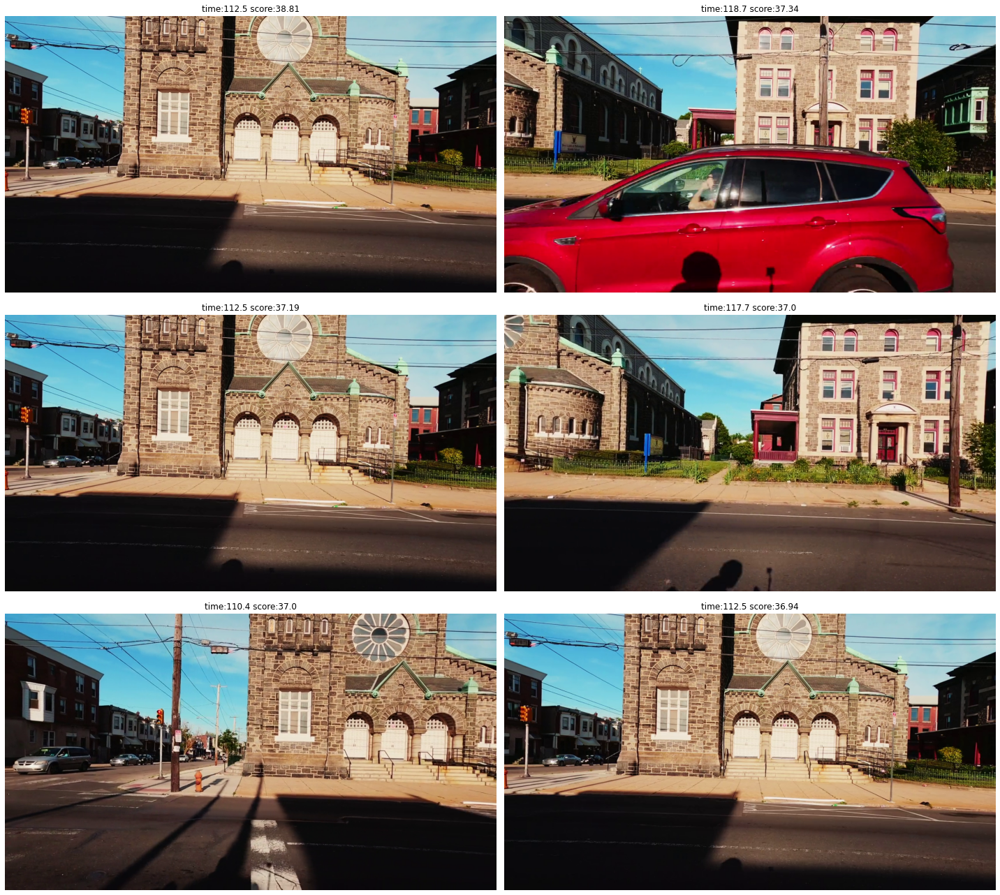

In [ ]:
# I thought that this was surpisingly good.
show_results(index.search('a church'))

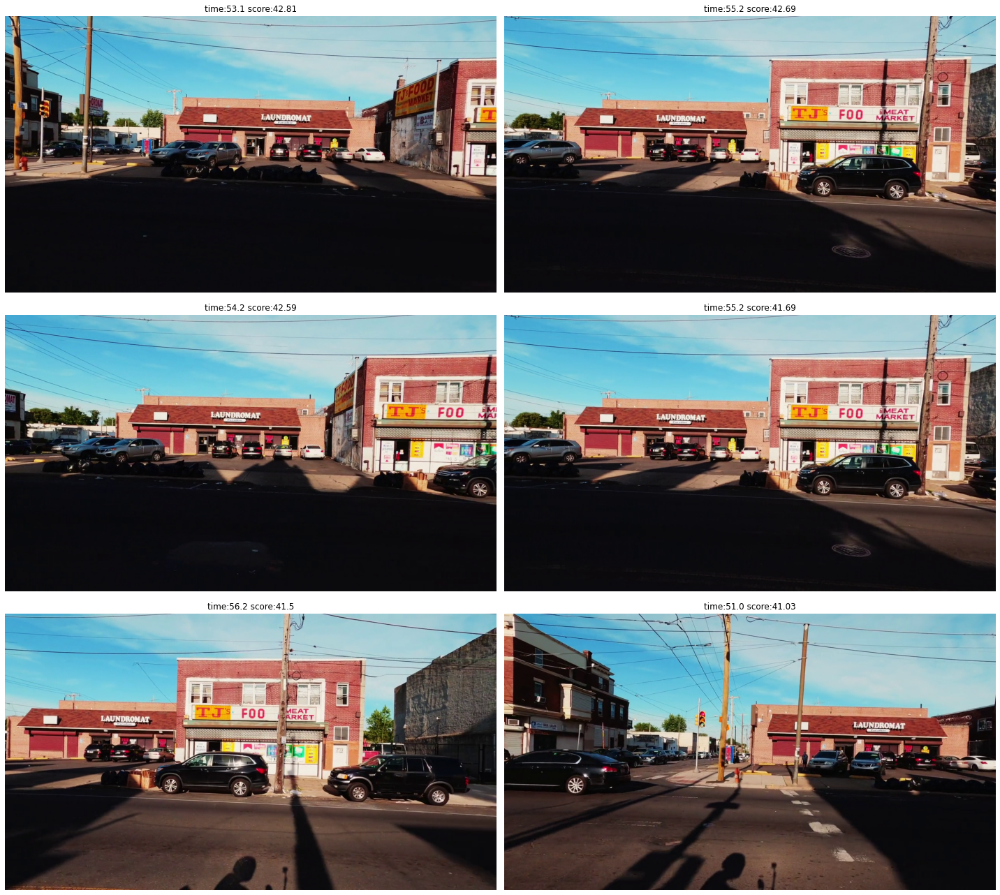

In [ ]:
# More text matching
show_results(index.search('a laundromat sign'))

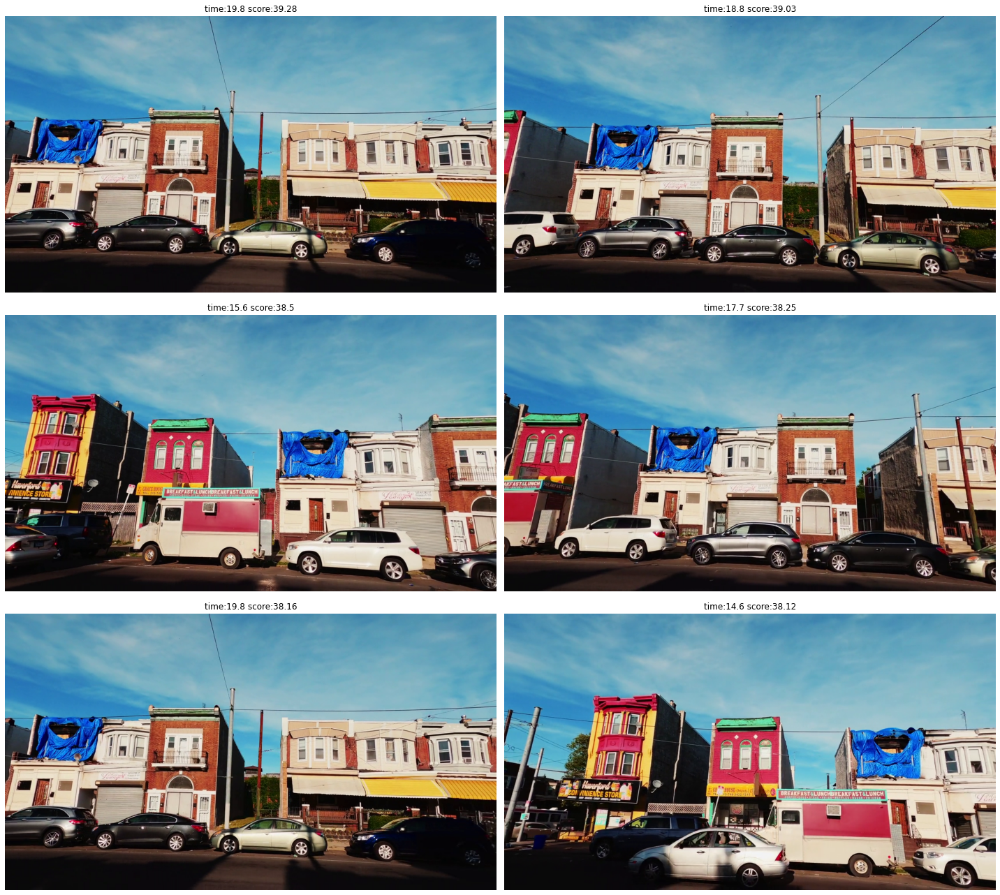

In [ ]:
show_results(index.search('a blue tarp'))

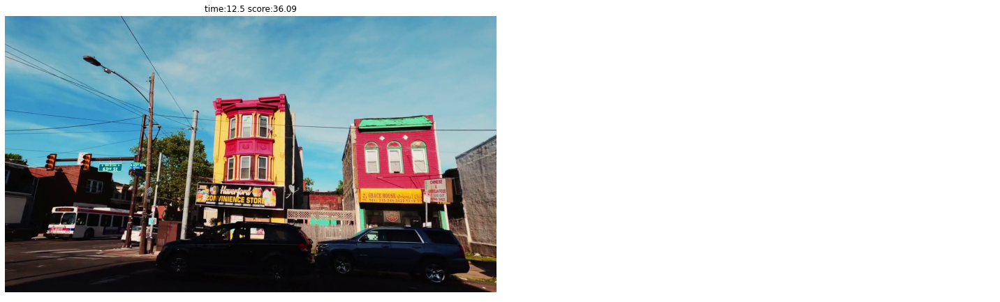

In [ ]:
# Only top hit was good for me
show_results(index.search('a bus',n=1))

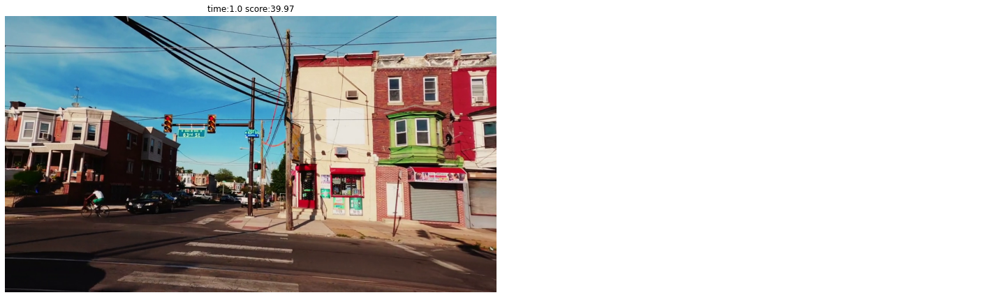

In [ ]:
# Only top hit was good for me
show_results(index.search('a man on a bicycle',n=1))

## Other CLIP Models
This notebook uses the "RN50x4" model.  Here are some other CLIP 
models that you might want to give try.

In [ ]:
clip.available_models()

['RN50', 'RN101', 'RN50x4', 'RN50x16', 'ViT-B/32', 'ViT-B/16']

## Write a Search Result Out to a File

In [ ]:
def write_search(index, query, fn):
  r = index.search(query,n=1)
  if len(r) > 0:
    f = video_frame(r[0]['path'],r[0]['t'])
    f = cv2.cvtColor(f,cv2.COLOR_RGB2BGR)
    cv2.imwrite(fn,f)

In [ ]:
write_search(index,'a woman in pink pant','pink_pants.jpg')

In [ ]:
write_search(index,'a laundromat sign', 'laundromat.jpg')

For updates and more content follow me on twitter [@johnrobinsn](https://www.twitter.com/johnrobinsn) or on my blog [storminthecastle.com](https://www.storminthecastle.com).